# Chicago E-scooter Pilot Program

The city of Chicago ran a pilot program in 2020 (from August to December) where 10,000 ride share e-scooters were permitted to operate within allocated community areas. 3 vendors participated in the trail each supplying 1/3 of the e-scooters.

The below map displays the area of Chicago involed within the pilot program. The areas in grey are the community areas participating in the program. The areas in red are communities and high traffic regions which e-scooter use is prohibited. The area within the blue line outlines the equity priority area. The equity priority area "covers neighborhoods where residents face
systemic disadvantages following generations of underinvestment and inequitable access to resources". As part of the escooter program at least 50% of the vendors escooters must be deployed within this area. 
More information regarding the escooter program can be found [here](https://www.chicago.gov/content/dam/city/depts/cdot/Misc/EScooters/2020/2020%20E-scooter%20Pilot%20FAQ%20-%20Final.pdf).


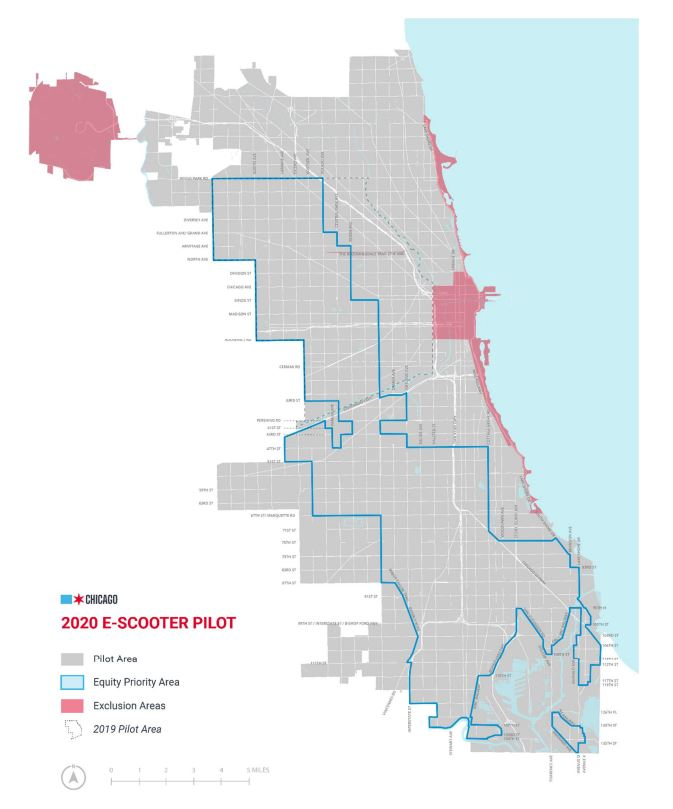

In [1]:
from IPython.display import Image
Image(filename='Data\escooter_pilot_map.JPG',width = "600",height = "300")

In [2]:
import pandas as pd
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt 
from matplotlib.pyplot import figure
import folium
import geopandas as gpd
import warnings
warnings.filterwarnings('ignore')

C:\Users\User\anaconda3\lib\site-packages\geopandas\_compat.py:106: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  warnings.warn(


# 1. E-scooter Data Exploration

## 1.1 Importing Data

The [E-Scooter_Trips_-_2020](https://data.cityofchicago.org/Transportation/E-Scooter-Trips-2020/3rse-fbp6) data set contains trip data collected during the trial. The data was comprised of the following attributes:
* Trip ID: unique ID for each trip
* Start Time: when trip started, rounded to nearest hour
* End Time: when trip ended, rounded to nearest hour
* Trip Distance: trip distance in meters
* Trip Duration: trip time in seconds
* Vendor: the vendor of the scooter
* Start Community Area Number: The community area number where trip started 
* End Community Area Number: The community area number where trip ended
* Start Community Area Name: The community area name where trip started 
* End Community Area Name: The community area name where trip ended
* Start Centroid Location: the center of the community area in which the trip started
* End Centroid Location: the center of the community area in which the trip ended  


In [3]:
escoot = pd.read_csv("Data/E-Scooter_Trips_-_2020.csv", index_col='Trip ID')
escoot = escoot[['Start Time', 'End Time', 'Trip Distance', 'Trip Duration', 'Vendor', 'Start Community Area Name','Start Community Area Number', 'End Community Area Name', 'End Community Area Number',  'Start Centroid Location', 'End Centroid Location']]
escoot.head()

,Start Time,End Time,Trip Distance,Trip Duration,Vendor,Start Community Area Name,Start Community Area Number,End Community Area Name,End Community Area Number,Start Centroid Location,End Centroid Location
Trip ID,,,,,,,,,,,
3eb9a2a3-3266-4559-b1ec-e83a6f7972ab,08/12/2020 05:00:00 AM,08/12/2020 05:00:00 AM,1153,1027,spin,ENGLEWOOD,68.0,ENGLEWOOD,68.0,POINT (-87.64226608 41.78006847),POINT (-87.64226608 41.78006847)
82dd7b8f-8de0-4f25-829b-b32bf47e8419,08/12/2020 05:00:00 AM,08/12/2020 05:00:00 AM,17,91,spin,LOGAN SQUARE,22.0,AVONDALE,21.0,POINT (-87.70430082 41.92290349),POINT (-87.71075685 41.93928256)
9120cbf3-f749-49b6-b894-0e6e065cd731,08/12/2020 05:00:00 AM,08/12/2020 05:00:00 AM,2883,724,spin,UPTOWN,3.0,LAKE VIEW,6.0,POINT (-87.65514456 41.96543532),POINT (-87.65749768 41.9435138)
cf2e4abc-2649-49be-924b-468a1aefc4c8,08/12/2020 05:00:00 AM,08/12/2020 05:00:00 AM,5,21,spin,LOWER WEST SIDE,31.0,LOWER WEST SIDE,31.0,POINT (-87.67517932 41.84833501),POINT (-87.67517932 41.84833501)
0448afb5-ab64-4090-b528-e3050e7eb0f2,08/12/2020 07:00:00 AM,08/12/2020 07:00:00 AM,1179,245,spin,LAKE VIEW,6.0,LAKE VIEW,6.0,POINT (-87.65749768 41.9435138),POINT (-87.65749768 41.9435138)


In [4]:
#split start and end date and time 
escoot.insert(0,'Start_Date',escoot["Start Time"].apply(lambda x: x.split(" ")[0]))
escoot.insert(1,'Start_Time',escoot["Start Time"].apply(lambda x: x.split(" ")[1]+" "+x.split(" ")[2]))
escoot.insert(2,'End_Date',escoot["End Time"].apply(lambda x: x.split(" ")[0]))
escoot.insert(3,'End_Time',escoot["End Time"].apply(lambda x: x.split(" ")[1]+" "+x.split(" ")[2]))
escoot.drop(['Start Time', 'End Time'], axis = 1, inplace=True)
escoot.head()

,Start_Date,Start_Time,End_Date,End_Time,Trip Distance,Trip Duration,Vendor,Start Community Area Name,Start Community Area Number,End Community Area Name,End Community Area Number,Start Centroid Location,End Centroid Location
Trip ID,,,,,,,,,,,,,
3eb9a2a3-3266-4559-b1ec-e83a6f7972ab,08/12/2020,05:00:00 AM,08/12/2020,05:00:00 AM,1153,1027,spin,ENGLEWOOD,68.0,ENGLEWOOD,68.0,POINT (-87.64226608 41.78006847),POINT (-87.64226608 41.78006847)
82dd7b8f-8de0-4f25-829b-b32bf47e8419,08/12/2020,05:00:00 AM,08/12/2020,05:00:00 AM,17,91,spin,LOGAN SQUARE,22.0,AVONDALE,21.0,POINT (-87.70430082 41.92290349),POINT (-87.71075685 41.93928256)
9120cbf3-f749-49b6-b894-0e6e065cd731,08/12/2020,05:00:00 AM,08/12/2020,05:00:00 AM,2883,724,spin,UPTOWN,3.0,LAKE VIEW,6.0,POINT (-87.65514456 41.96543532),POINT (-87.65749768 41.9435138)
cf2e4abc-2649-49be-924b-468a1aefc4c8,08/12/2020,05:00:00 AM,08/12/2020,05:00:00 AM,5,21,spin,LOWER WEST SIDE,31.0,LOWER WEST SIDE,31.0,POINT (-87.67517932 41.84833501),POINT (-87.67517932 41.84833501)
0448afb5-ab64-4090-b528-e3050e7eb0f2,08/12/2020,07:00:00 AM,08/12/2020,07:00:00 AM,1179,245,spin,LAKE VIEW,6.0,LAKE VIEW,6.0,POINT (-87.65749768 41.9435138),POINT (-87.65749768 41.9435138)


In [5]:
escoot.info()

<class 'pandas.core.frame.DataFrame'>
Index: 630816 entries, 3eb9a2a3-3266-4559-b1ec-e83a6f7972ab to 758cd2bd-45da-4c2c-b73a-8a07de69bd22
Data columns (total 13 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Start_Date                   630816 non-null  object 
 1   Start_Time                   630816 non-null  object 
 2   End_Date                     630816 non-null  object 
 3   End_Time                     630816 non-null  object 
 4   Trip Distance                630816 non-null  int64  
 5   Trip Duration                630816 non-null  int64  
 6   Vendor                       630816 non-null  object 
 7   Start Community Area Name    629934 non-null  object 
 8   Start Community Area Number  629934 non-null  float64
 9   End Community Area Name      629598 non-null  object 
 10  End Community Area Number    629598 non-null  float64
 11  Start Centroid Location      629934 non-null  object 
 12

In [6]:
#number of total trips
print(f'Total number of trips: {escoot.shape[0]}')

Total number of trips: 630816


In [7]:
#participating vendors 
print(f'Participating vendors: {set(escoot["Vendor"])}')

Participating vendors: {'spin', 'bird', 'lime'}


In [8]:
#number of community areas
print(f'Number of participating community areas: {len(set(escoot["Start Community Area Name"]))}')

Number of participating community areas: 78


In [9]:
#Descriptive statistics for distance and time traveled
round(escoot[["Trip Distance", "Trip Duration"]].describe(),2)

,Trip Distance,Trip Duration
count,630816.00,630816.00
mean,2909.79,996.03
std,3715.63,1356.65
min,1.00,0.00
25%,822.00,305.00
50%,1869.00,571.00
75%,3645.00,1128.00
max,49997.00,204182.00


The trip mean distance is 2.91 kms with a minimum trip of 1 m and a maximum tip of 50 km. 

The trip distance data has a coefficient of variation of 1.28. This value is large and may be effected by outliers.

The trip mean duration is 16 mins and 36 secs, with a minimum trip of 0 seconds and a maximum trip of 56 hours 42 mins 36 secs.

The trip duration data has a coefficient of variation of 1.36. This value is large and may be effected by outliers. 

## 1.2 Identifying and Addressing Outliers

The descriptive statistics indicate that a number of outliers may be present within the data which are influencing the results. A cut off range was established as 3 standard deviations from the mean and these values were dropped from the data. 

Also, trips that were less then 5 seconds in duration were dropped.

In [10]:
#identify outlier ranges
# Function to detect outlier
def find_anomalies(data):
    #define a list to accumlate anomalies
    anomalies = []
    
    # Set upper and lower limit to 3 standard deviation
    data_std = data.std()
    data_mean = data.mean()
    anomaly_cut_off = data_std * 3
    
    lower_limit  = data_mean - anomaly_cut_off 
    upper_limit = data_mean + anomaly_cut_off
    return (lower_limit,upper_limit)

print(f'Lower and upper outlier limit for trip distance: {find_anomalies(escoot["Trip Distance"])}')
print(f'Lower and upper outlier limit for trip duration: {find_anomalies(escoot["Trip Duration"])}')

Lower and upper outlier limit for trip distance: (-8237.0948153971, 14056.680926085479)
Lower and upper outlier limit for trip duration: (-3073.9246077063794, 5065.983068493677)


In [11]:
print(f'The number of tuples with an outlier distance is: {escoot[escoot["Trip Distance"] > find_anomalies(escoot["Trip Distance"])[1]].shape[0]} ')
print(f'The number of tuples with an outlier duration is: {escoot[escoot["Trip Duration"] > find_anomalies(escoot["Trip Distance"])[1]].shape[0]} ')


The number of tuples with an outlier distance is: 12356 
The number of tuples with an outlier duration is: 16 


In [12]:
#drop outliers from table
escoot.drop(escoot[escoot["Trip Distance"] > find_anomalies(escoot["Trip Distance"])[1]].index, inplace=True)
escoot.drop(escoot[escoot["Trip Duration"] > find_anomalies(escoot["Trip Distance"])[1]].index, inplace=True)

In [13]:
print(f'The number of tips with a duration of less then 5 seconds was : {escoot[escoot["Trip Duration"] <=5 ].shape[0]}')

The number of tips with a duration of less then 5 seconds was : 83


In [14]:
#drop tuples with trip duration < 5 seconds
escoot.drop(escoot[escoot["Trip Duration"] <= 5].index, inplace=True)

In [15]:
#Descriptive statistics for distance and time traveled (outliers removed)
round(escoot[["Trip Distance", "Trip Duration"]].describe(),2)

,Trip Distance,Trip Duration
count,617231.00,617231.00
mean,2543.89,902.26
std,2519.68,1048.04
min,1.00,6.00
25%,802.00,301.00
50%,1822.00,558.00
75%,3483.00,1079.00
max,14056.00,10113.00


Upon the removal of outliers the trip mean distance is 2.5km with a min of 1 m and max of 14.06km. 

The coefficient of variation was reduced to 0.99.

The trip mean duration is 15mins 2 secs with a minimum of 6 seconds and maximum of 2 hrs 48 mins and 33 seconds. 

The coefficient of variantion was reduced to 1.16.


## 1.3 Investigating Null Values

A number of null values exist within the data set and these null values were investigated. 

In [16]:
#count null values 
escoot.isnull().sum()

Start_Date                        0
Start_Time                        0
End_Date                          0
End_Time                          0
Trip Distance                     0
Trip Duration                     0
Vendor                            0
Start Community Area Name       874
Start Community Area Number     874
End Community Area Name        1113
End Community Area Number      1113
Start Centroid Location         874
End Centroid Location          1113
dtype: int64

In [17]:
#What percentage of rides contain a start or end null value in the community name field? 
total_null_rows = (escoot.isnull().values.ravel().sum())/6
perc_null_rows = round((total_null_rows/escoot.shape[0])*100,2)
print(f'Percentage of rows containing a null value: {perc_null_rows}%')

Percentage of rows containing a null value: 0.16%


A number of start community area name and end community area name data fields are null.

In [18]:
escoot_null = escoot[escoot.isnull().any(axis=1)]
escoot_null.head()

,Start_Date,Start_Time,End_Date,End_Time,Trip Distance,Trip Duration,Vendor,Start Community Area Name,Start Community Area Number,End Community Area Name,End Community Area Number,Start Centroid Location,End Centroid Location
Trip ID,,,,,,,,,,,,,
90301f3f-8ff7-4982-974b-a1f5c80aa4c2,08/12/2020,04:00:00 PM,08/12/2020,05:00:00 PM,9769,3390,bird,UPTOWN,3.0,NaN,NaN,POINT (-87.65514456 41.96543532),NaN
71d6dfd4-1e33-4f73-b912-d3e8b0319b39,08/12/2020,08:00:00 PM,08/12/2020,09:00:00 PM,13947,3285,lime,LINCOLN PARK,7.0,NaN,NaN,POINT (-87.64564651 41.92188043),NaN
44a90125-018c-40a5-b2ae-916b4e6cc6c5,08/13/2020,11:00:00 AM,08/13/2020,12:00:00 PM,9451,2831,lime,AUSTIN,25.0,NaN,NaN,POINT (-87.7578251 41.89081229),NaN
58ae657c-c640-4ae6-b405-c58fa6a9ca02,08/13/2020,01:00:00 PM,08/13/2020,01:00:00 PM,510,300,lime,NaN,NaN,NaN,NaN,NaN,NaN
5e078871-f37b-4859-b016-c065fe077607,08/13/2020,02:00:00 PM,08/13/2020,02:00:00 PM,2449,901,lime,NaN,NaN,NaN,NaN,NaN,NaN


In [19]:
#import community geojson data for mapping community areas
chicago_geojson = gpd.read_file("Data\Boundaries - Community Areas (current).geojson")
chicago_geojson['community'] = chicago_geojson['community'].str.upper()
chicago_geojson = chicago_geojson.drop(['perimeter', 'area', 'area_num_1', 'shape_len', 'comarea_id', 'comarea'], axis=1)
chicago_geojson.sort_values('community', inplace=True)
chicago_geojson.set_index('community',inplace=True)
chicago_geojson.head()

,shape_area,area_numbe,geometry
community,,,
ALBANY PARK,53542230.8191,14,"MULTIPOLYGON (((-87.70404 41.97355, -87.70403 ..."
ARCHER HEIGHTS,55922505.7212,57,"MULTIPOLYGON (((-87.71437 41.82604, -87.71436 ..."
ARMOUR SQUARE,27766196.0954,34,"MULTIPOLYGON (((-87.62917 41.84556, -87.62947 ..."
ASHBURN,135460337.208,70,"MULTIPOLYGON (((-87.71255 41.75734, -87.71252 ..."
AUBURN GRESHAM,105065353.602,71,"MULTIPOLYGON (((-87.63990 41.75615, -87.63990 ..."


In [20]:
#join data set which contain null values 
start_null = pd.DataFrame(escoot_null['Start Community Area Name'].value_counts())
end_null = pd.DataFrame(escoot_null['End Community Area Name'].value_counts())
comm_null = pd.concat([start_null, end_null], axis = 1)
comm_null = pd.concat([chicago_geojson,comm_null], axis = 1)
comm_null.fillna(0, inplace = True)
comm_null.reset_index(inplace = True)
comm_null.rename(
    columns={'index':'Community', 'shape_area':'Area', 'area_numbe':'Area_Num', 'geometry':'geometry', 'Start Community Area Name':'Start_Null', 'End Community Area Name':'End_Null'}, 
    inplace=True)
comm_null.head(10)

,Community,Area,Area_Num,geometry,Start_Null,End_Null
0,ALBANY PARK,53542230.8191,14,"MULTIPOLYGON (((-87.70404 41.97355, -87.70403 ...",1.0,2.0
1,ARCHER HEIGHTS,55922505.7212,57,"MULTIPOLYGON (((-87.71437 41.82604, -87.71436 ...",6.0,1.0
2,ARMOUR SQUARE,27766196.0954,34,"MULTIPOLYGON (((-87.62917 41.84556, -87.62947 ...",1.0,0.0
3,ASHBURN,135460337.208,70,"MULTIPOLYGON (((-87.71255 41.75734, -87.71252 ...",3.0,2.0
4,AUBURN GRESHAM,105065353.602,71,"MULTIPOLYGON (((-87.63990 41.75615, -87.63990 ...",11.0,1.0
5,AUSTIN,199254203.427,25,"MULTIPOLYGON (((-87.78942 41.91751, -87.78927 ...",154.0,102.0
6,AVALON PARK,34852737.7366,45,"MULTIPOLYGON (((-87.58566 41.75150, -87.58475 ...",1.0,0.0
7,AVONDALE,55290595.473,21,"MULTIPOLYGON (((-87.68799 41.93610, -87.68798 ...",5.0,1.0
8,BELMONT CRAGIN,109099414.689,19,"MULTIPOLYGON (((-87.74134 41.91390, -87.74167 ...",35.0,24.0
9,BEVERLY,88779363.9384,72,"MULTIPOLYGON (((-87.67308 41.73566, -87.66975 ...",20.0,6.0


In [21]:
#mapping start and end area name data that was null to identify patterns 
#community areas can be selected and will show community area name, number of nulls for start of journey and number of nulls for end of journey.
m = folium.Map(location=[41.848, -87.629], zoom_start=11, tiles='CartoDB positron', zoom_control=False,scrollWheelZoom=False,dragging=False)
folium.Choropleth(
    geo_data=comm_null,
    name="choropleth",
    data=comm_null,
    columns=["Community", "Start_Null"],
    key_on="feature.properties.Community",
    fill_color="PuRd",
    line_color = 'grey',
    line_weight = 2,
    fill_opacity=0.7,
    line_opacity=1,
    legend_name="Number of trips with Null Start",
).add_to(m)

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}

highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

folium.features.GeoJson(
    comm_null, name = 'Community', 
    popup=folium.features.GeoJsonPopup(fields=['Community','Start_Null', 'End_Null']),
    style_function = style_function,
    highlight_function = highlight_function,
    ).add_to(m)
folium.LayerControl().add_to(m)
m

The community areas with the most start and end community name null values border the exlusion zones for the escooter pilot program. It can be infered that these values are null as users are starting or finishing their journies outside of the permitted pilot program zone. As such the GPS data for these values have been exluded from the data.

The largest number of nulls for both start and end community name feild was in the Austin. Further investigation is recomended into why more more trips start or end outside of the allocated escooter area within the Austin community area. 

<Figure size 864x432 with 0 Axes>

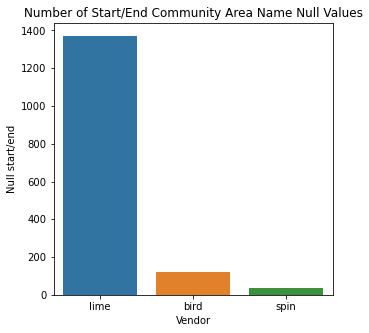

In [22]:
# Distribution of null values in the start and end community area field between vendors
plt.figure(figsize=(12,6))
ven_null = pd.DataFrame(escoot_null['Vendor'].value_counts())
ven_null.reset_index(inplace=True)
ven_null.rename(
    columns={'index':'Vendor', 'Vendor':'Null start/end'}, 
    inplace=True)

figure(figsize=(5,5))
ax = sns.barplot(x='Vendor', y='Null start/end', data = ven_null)
ax.set(title='Number of Start/End Community Area Name Null Values')
plt.show()

The Lime vendor make up the majority of trips with a start or end null value for the community name field. This may be due higher distribution of this vendors escooters within areas such as Austin on the pilot program border or an issue with how this vendor is communicating the location of exlusion zones to the user. Investigation should be undertaken to understand why users are taking Lime scooters outside of the permitted usage zones.

## 1.4 Distribution of Trip Volume by Starting Location Between Community Areas

The data was investigated to understand the distribution of trip starting locations across the city. 

In [23]:
#data frame group by start community name 
trip_start = escoot.groupby(["Start Community Area Name", "Vendor"], as_index= False).size()
trip_start = trip_start.pivot(index = 'Start Community Area Name', columns = 'Vendor', values = 'size').fillna(0)
trip_start["Total Trips"] = trip_start["bird"]+trip_start["lime"]+trip_start["spin"]
trip_start.head()

Vendor,bird,lime,spin,Total Trips
Start Community Area Name,,,,
ALBANY PARK,294,641,1609,2544
ARCHER HEIGHTS,306,1802,803,2911
ARMOUR SQUARE,621,1464,466,2551
ASHBURN,524,553,216,1293
AUBURN GRESHAM,557,3451,1352,5360


In [24]:
#descriptive statistics of start community area volume
round(trip_start.describe(), 2)

Vendor,bird,lime,spin,Total Trips
count,77.00,77.00,77.00,77.00
mean,2252.70,3611.05,2140.88,8004.64
std,4673.21,6877.95,5692.60,16220.54
min,3.00,3.00,1.00,15.00
25%,237.00,562.00,219.00,1298.00
50%,845.00,1726.00,722.00,3263.00
75%,1552.00,3230.00,1352.00,5902.00
max,29153.00,39425.00,44697.00,98588.00


The mean number of trips starting within a community area is 8,004.64. The standard deviation is large suggesting a significant range of values between the number of starting trips within community areas.  

Text(0.5, 1.0, 'Start Location Histogram')

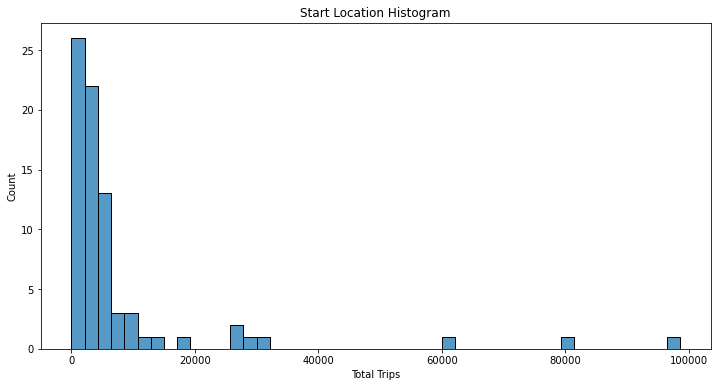

In [25]:
#Distribution of community areas by start location count
plt.figure(figsize=(12,6))
sns.histplot(x = trip_start["Total Trips"])
plt.title('Start Location Histogram')

The histogram shows the a significant right skew with only 3 community areas having total trips starting within that community numbering above 50,000. The majority of community areas was a starting location for less then 20,000 trips. 

[Text(0.5, 1.0, 'Top 10 Community Areas Starting Location by Volume')]

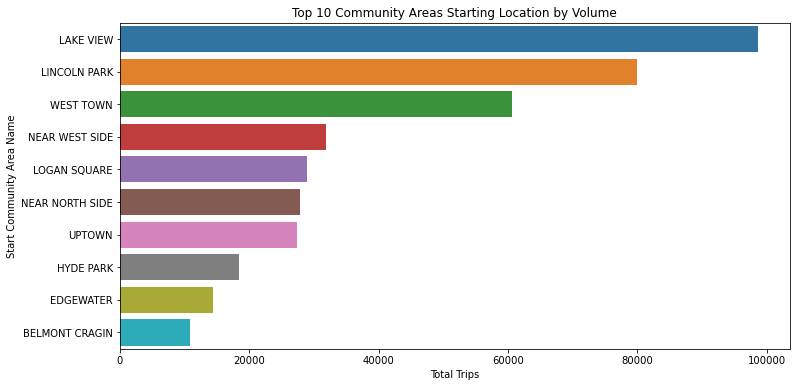

In [26]:
#top 10 community areas by start
plt.figure(figsize=(12,6))
top10_start_volume = trip_start.sort_values(by = 'Total Trips', ascending= False).head(10)
sns.barplot(x='Total Trips', y = top10_start_volume.index , data = top10_start_volume).set(title = 'Top 10 Community Areas Starting Location by Volume')

[Text(0.5, 1.0, 'Bottom 10 Community Areas Starting Location by Volume')]

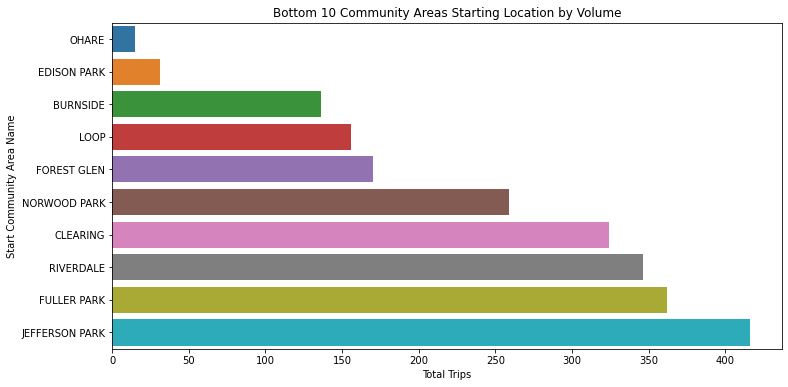

In [27]:
#bottom 10 community areas by start
plt.figure(figsize=(12,6))
bot10_start_volume = trip_start.sort_values(by = 'Total Trips', ascending= True).head(10)
sns.barplot(y= bot10_start_volume.index , x='Total Trips', data = bot10_start_volume).set(title = 'Bottom 10 Community Areas Starting Location by Volume' )

In [28]:
trip_start = pd.concat([chicago_geojson, trip_start], axis=1)
trip_start.dropna(inplace = True)
trip_start.reset_index(inplace=True)
trip_start.rename(
    columns={'index':'community'}, 
    inplace=True)
trip_start.head()

,community,shape_area,area_numbe,geometry,bird,lime,spin,Total Trips
0,ALBANY PARK,53542230.8191,14,"MULTIPOLYGON (((-87.70404 41.97355, -87.70403 ...",294,641,1609,2544
1,ARCHER HEIGHTS,55922505.7212,57,"MULTIPOLYGON (((-87.71437 41.82604, -87.71436 ...",306,1802,803,2911
2,ARMOUR SQUARE,27766196.0954,34,"MULTIPOLYGON (((-87.62917 41.84556, -87.62947 ...",621,1464,466,2551
3,ASHBURN,135460337.208,70,"MULTIPOLYGON (((-87.71255 41.75734, -87.71252 ...",524,553,216,1293
4,AUBURN GRESHAM,105065353.602,71,"MULTIPOLYGON (((-87.63990 41.75615, -87.63990 ...",557,3451,1352,5360


In [29]:
#mapping start community area name by volume of trips 
#community areas can be selected and will show community area name and number of trips starting from the selected area
m = folium.Map(location=[41.848, -87.629], zoom_start=11, tiles='CartoDB positron', zoom_control=False,scrollWheelZoom=False,dragging=False)
folium.Choropleth(
    geo_data=trip_start,
    name="choropleth",
    data=trip_start,
    columns=["community", "Total Trips"],
    key_on="feature.properties.community",
    fill_color="PiYG",
    line_color = 'grey',
    line_weight = 2,
    fill_opacity=0.7,
    line_opacity=1,
    legend_name="Volume of trips starting in community area",
).add_to(m)

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}

highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

folium.features.GeoJson(
    trip_start, name = 'Community', 
    popup=folium.features.GeoJsonPopup(fields=['community','Total Trips']),
    style_function = style_function,
    highlight_function = highlight_function,
    ).add_to(m)
folium.LayerControl().add_to(m)
m

The most popular starting point locations for escooter trips was the communities of Lake View, Lincoln Park and West Town. These community areas are located to the north of the city and are the location of a number of tourist attractions such as North Avenue Beach, Lincoln park and zoo, Diversey Habour and a number of large parks. 

The least popular starting locations were Ohare, Edison Park, Burnside and the Loop. Edison park and Burnside are geographically small communities which may explain the lack of trips starting from these communities. Ohare and the Loop are zones of exlusion for the program as outlined by the E-Scooter Pilot Map.

The data was investigated to understand the distribution trip end locations. 

## 1.5 Distribution of Trip Volume by End Location Between Community Areas

In [30]:
#data frame group by start community name 
trip_end = escoot.groupby(["End Community Area Name", "Vendor"], as_index= False).size()
trip_end = trip_end.pivot(index = 'End Community Area Name', columns = 'Vendor', values = 'size').fillna(0)
trip_end["Total Trips"] = trip_end["bird"]+trip_end["lime"]+trip_end["spin"]
trip_end.head()

Vendor,bird,lime,spin,Total Trips
End Community Area Name,,,,
ALBANY PARK,387,736,1627,2750
ARCHER HEIGHTS,308,1693,757,2758
ARMOUR SQUARE,569,1456,445,2470
ASHBURN,559,644,263,1466
AUBURN GRESHAM,598,3333,1287,5218


In [31]:
#descriptive statistics of end community area volume
round(trip_end.describe(), 2)

Vendor,bird,lime,spin,Total Trips
count,77.00,77.00,77.00,77.00
mean,2251.66,3609.39,2140.48,8001.53
std,4567.11,6744.58,5601.32,16049.73
min,7.00,8.00,3.00,24.00
25%,265.00,644.00,244.00,1466.00
50%,880.00,1693.00,697.00,3383.00
75%,1620.00,3174.00,1373.00,5979.00
max,27047.00,38001.00,43588.00,97867.00


Text(0.5, 1.0, 'End Location Histogram')

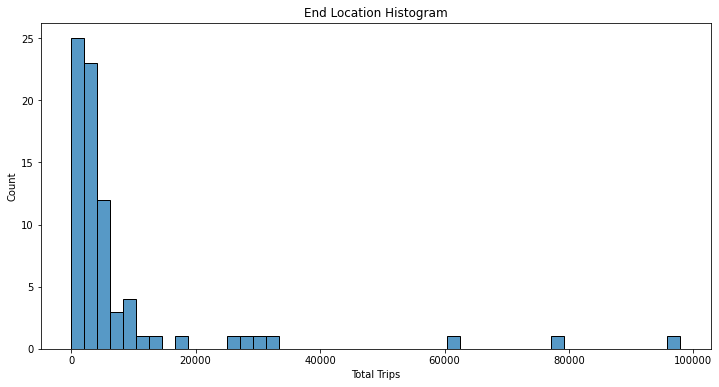

In [32]:
#Distribution of community areas by end location count
plt.figure(figsize=(12,6))
sns.histplot(x = trip_end["Total Trips"])
plt.title('End Location Histogram')

[Text(0.5, 1.0, 'Top 10 Community Areas Ending Location by Volume')]

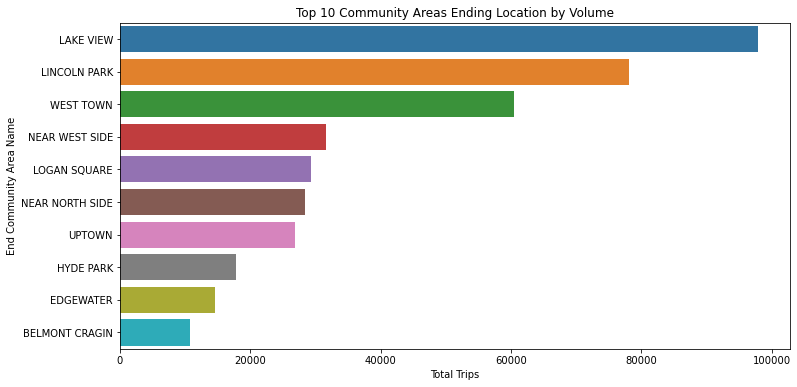

In [33]:
#top 10 community areas by end 
plt.figure(figsize=(12,6))
top10_end_volume = trip_end.sort_values(by = 'Total Trips', ascending= False).head(10)
sns.barplot(x='Total Trips', y = top10_end_volume.index , data = top10_end_volume).set(title = 'Top 10 Community Areas Ending Location by Volume')

[Text(0.5, 1.0, 'Bottom 10 Community Areas End Location by Volume')]

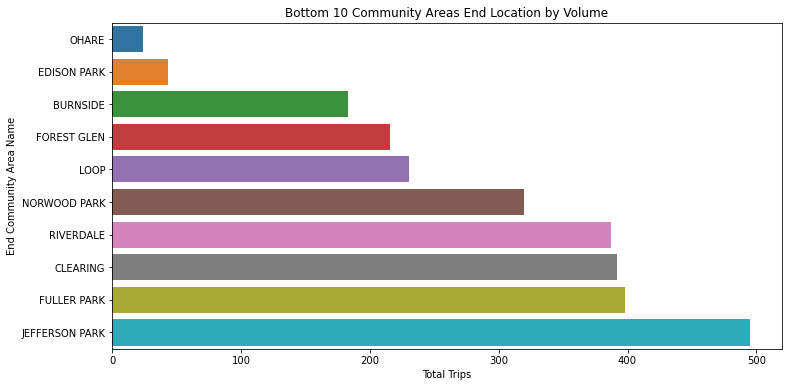

In [34]:
#bottom 10 community areas by end
plt.figure(figsize=(12,6))
bot10_end_volume = trip_end.sort_values(by = 'Total Trips', ascending= True).head(10)
sns.barplot(y= bot10_end_volume.index , x='Total Trips', data = bot10_end_volume).set(title = 'Bottom 10 Community Areas End Location by Volume' )


In [35]:
trip_end = pd.concat([chicago_geojson, trip_end], axis=1)
trip_end.dropna(inplace = True)
trip_end.reset_index(inplace=True)
trip_end.rename(
    columns={'index':'community'}, 
    inplace=True)
trip_end.head()

,community,shape_area,area_numbe,geometry,bird,lime,spin,Total Trips
0,ALBANY PARK,53542230.8191,14,"MULTIPOLYGON (((-87.70404 41.97355, -87.70403 ...",387,736,1627,2750
1,ARCHER HEIGHTS,55922505.7212,57,"MULTIPOLYGON (((-87.71437 41.82604, -87.71436 ...",308,1693,757,2758
2,ARMOUR SQUARE,27766196.0954,34,"MULTIPOLYGON (((-87.62917 41.84556, -87.62947 ...",569,1456,445,2470
3,ASHBURN,135460337.208,70,"MULTIPOLYGON (((-87.71255 41.75734, -87.71252 ...",559,644,263,1466
4,AUBURN GRESHAM,105065353.602,71,"MULTIPOLYGON (((-87.63990 41.75615, -87.63990 ...",598,3333,1287,5218


In [36]:
#mapping end community area name by volume of trips 
#community areas can be selected and will show community area name and number of trips starting from the selected area
m = folium.Map(location=[41.848, -87.629], zoom_start=11, tiles='CartoDB positron', zoom_control=False,scrollWheelZoom=False,dragging=False)
folium.Choropleth(
    geo_data=trip_end,
    name="choropleth",
    data=trip_end,
    columns=["community", "Total Trips"],
    key_on="feature.properties.community",
    fill_color="PiYG",
    line_color = 'grey',
    line_weight = 2,
    fill_opacity=0.7,
    line_opacity=1,
    legend_name="Volume of trips ending in community area",
).add_to(m)

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}

highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

folium.features.GeoJson(
    trip_end, name = 'Community', 
    popup=folium.features.GeoJsonPopup(fields=['community','Total Trips']),
    style_function = style_function,
    highlight_function = highlight_function,
    ).add_to(m)
folium.LayerControl().add_to(m)
m

The descriptive statistics and the distribution of trip end volume by community area is similar to that of the trip start data. This would suggest that many of the trips undertaken by e-scooter are localised to within the community area. This can be further explored by comparing the difference between trip start and trip end volume within each community area. 

## 1.6 Migration of E-scooter Trips between Community Areas

The data was explored to identify the difference between the number of trips started within each community area to the number of trips which ended within that community area. This will give an indication if e-scooter trips are migrating towards or away from specific community areas.

In [37]:
trip_end.drop(columns=['shape_area', 'area_numbe', 'geometry'], inplace=True)
trip_dif = pd.merge(trip_start, trip_end, how= 'inner', on='community')
trip_dif['Difference in Volume'] = trip_dif['Total Trips_y']-trip_dif['Total Trips_x']
trip_dif.drop(columns=['bird_x', 'lime_x', 'spin_x', 'Total Trips_x', 'bird_y', 'lime_y', 'spin_y', 'Total Trips_y'], inplace = True)
trip_dif.head()

,community,shape_area,area_numbe,geometry,Difference in Volume
0,ALBANY PARK,53542230.8191,14,"MULTIPOLYGON (((-87.70404 41.97355, -87.70403 ...",206
1,ARCHER HEIGHTS,55922505.7212,57,"MULTIPOLYGON (((-87.71437 41.82604, -87.71436 ...",-153
2,ARMOUR SQUARE,27766196.0954,34,"MULTIPOLYGON (((-87.62917 41.84556, -87.62947 ...",-81
3,ASHBURN,135460337.208,70,"MULTIPOLYGON (((-87.71255 41.75734, -87.71252 ...",173
4,AUBURN GRESHAM,105065353.602,71,"MULTIPOLYGON (((-87.63990 41.75615, -87.63990 ...",-142


In [38]:
#top 5 community areas incoming volume
top5_dif_volume = trip_dif.sort_values(by = 'Difference in Volume', ascending= False).head(10)
top5_dif_volume.drop(columns=['shape_area', 'area_numbe', 'geometry']).head(5)

,community,Difference in Volume
47,NEAR NORTH SIDE,507
51,NORTH CENTER,505
40,LOGAN SQUARE,474
39,LINCOLN SQUARE,465
74,WEST RIDGE,400


In [39]:
#top 5 community areas outgoing volume
bot5_dif_volume = trip_dif.sort_values(by = 'Difference in Volume', ascending= True).head(10)
bot5_dif_volume.drop(columns=['shape_area', 'area_numbe', 'geometry']).head(5)

,community,Difference in Volume
38,LINCOLN PARK,-1793
37,LAKE VIEW,-721
33,HYDE PARK,-654
66,UPTOWN,-591
57,PORTAGE PARK,-425


In [40]:
trip_dif.head()

,community,shape_area,area_numbe,geometry,Difference in Volume
0,ALBANY PARK,53542230.8191,14,"MULTIPOLYGON (((-87.70404 41.97355, -87.70403 ...",206
1,ARCHER HEIGHTS,55922505.7212,57,"MULTIPOLYGON (((-87.71437 41.82604, -87.71436 ...",-153
2,ARMOUR SQUARE,27766196.0954,34,"MULTIPOLYGON (((-87.62917 41.84556, -87.62947 ...",-81
3,ASHBURN,135460337.208,70,"MULTIPOLYGON (((-87.71255 41.75734, -87.71252 ...",173
4,AUBURN GRESHAM,105065353.602,71,"MULTIPOLYGON (((-87.63990 41.75615, -87.63990 ...",-142


In [41]:
#mapping difference between start and end of trips by community area 
#community areas can be selected and will show community area name and number of trips starting from the selected area
m = folium.Map(location=[41.848, -87.629], zoom_start=11, tiles='CartoDB positron', zoom_control=False,scrollWheelZoom=False,dragging=False)
folium.Choropleth(
    geo_data=trip_dif,
    name="choropleth",
    data=trip_dif,
    columns=["community", "Difference in Volume"],
    key_on="feature.properties.community",
    fill_color="Spectral",
    line_color = 'grey',
    line_weight = 2,
    fill_opacity=0.7,
    line_opacity=1,
    legend_name="Difference between Volume of Trip Ending and Trip Starting in a Community Area",
).add_to(m)

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}

highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

folium.features.GeoJson(
    trip_dif, name = 'Community', 
    popup=folium.features.GeoJsonPopup(fields=['community','Difference in Volume']),
    style_function = style_function,
    highlight_function = highlight_function,
    ).add_to(m)
folium.LayerControl().add_to(m)
m

A negative difference between end and start trip volume indicates users are starting a trip in that community area and ending their trip in another community area. The communities with the largest negative numbers include Lincoln Park, Lake View, Hyde Park and Uptown. The mapa above shows that these communiy areas are surrounded by community areas with posistive e-scooter migration. This would indicate that users are moving from these listed communities to the surrounding communities. 

It should be noted that the difference between start and end trip numbers are very small relative to the total number of trips taken within that community area. This would indicate that the majority of e-scooter trips start and finish within the same community area. 

## 1.7 E-scooter Usage During The Program by Number of Trips 

The data was investigated to understand the pattern of e-scooter usage over time. This involved exploring the number of trips during the time period, the total distances traveled and the total time duration. 

In [42]:
#Table with number of trips per day 
date_count = escoot.groupby(["Start_Date", "Vendor"], as_index= False).size()
date_count['Start_Date'] = date_count['Start_Date'].apply(pd.to_datetime)
date_count = date_count.pivot(index = 'Start_Date', columns = 'Vendor', values = 'size').fillna(0)
date_count['Total Trips'] = date_count['bird']+date_count['lime']+date_count['spin']
date_count.insert(0,'day_of_week',date_count.index.day_name())
date_count.head()

Vendor,day_of_week,bird,lime,spin,Total Trips
Start_Date,,,,,
2020-08-12,Wednesday,971,1830,880,3681
2020-08-13,Thursday,1535,2091,947,4573
2020-08-14,Friday,2538,1653,1231,5422
2020-08-15,Saturday,2824,1863,1521,6208
2020-08-16,Sunday,2865,2101,1716,6682


In [43]:
#descriptive statistics for total trips per day
round(date_count.describe(), 2)

Vendor,bird,lime,spin,Total Trips
count,123.00,123.00,123.00,123.00
mean,1410.41,2267.47,1340.25,5018.14
std,909.53,1239.24,892.29,2929.68
min,94.00,263.00,207.00,603.00
25%,618.50,1321.50,594.00,2570.50
50%,1281.00,1980.00,1231.00,4647.00
75%,2167.50,3112.00,1861.50,7178.00
max,3390.00,5612.00,3972.00,12553.00


The e-scooter program lasted for 123 days total with an average of 5,018.14 trips taken per day.

In [44]:
min_date = date_count.index[date_count['Total Trips'] == date_count['Total Trips'].min()]
max_date = date_count.index[date_count['Total Trips'] == date_count['Total Trips'].max()]

print(f' The date with the smallest number of trips was: {min_date[0].strftime("%Y-%m-%d")}')
print(f' The date with the largest number of trips was: {max_date[0].strftime("%Y-%m-%d")}')


 The date with the smallest number of trips was: 2020-12-12
 The date with the largest number of trips was: 2020-09-05


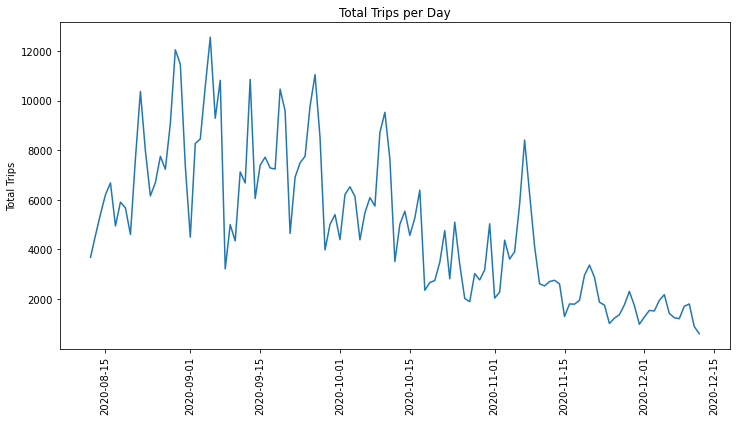

In [45]:
plt.figure(figsize=(12,6))
sns.lineplot(data = date_count, x = date_count.index, y = 'Total Trips')
plt.xticks(rotation=90)
plt.title('Total Trips per Day')
plt.xlabel('')
plt.show()

The number of trips per day can vary significantly from day to day. There was a initial peak in number of trips within the first couple of weeks of the pilot program. These numbers seemed reasonably consistent for the first month. From October 2020 the number of trips began to decline and continued to do so until the end of the pilot program.  

In [46]:
#number of trips by weekday
day_count = date_count.groupby('day_of_week', as_index= True).sum()
day_count.sort_values(by='Total Trips', inplace = True)
day_count.head(7)

Vendor,bird,lime,spin,Total Trips
day_of_week,,,,
Tuesday,18886,30565,17593,67044
Monday,20842,29338,18556,68736
Thursday,22355,37063,21321,80739
Wednesday,22645,37243,21810,81698
Sunday,27771,44473,26247,98491
Friday,28530,45105,25975,99610
Saturday,32452,55112,33349,120913


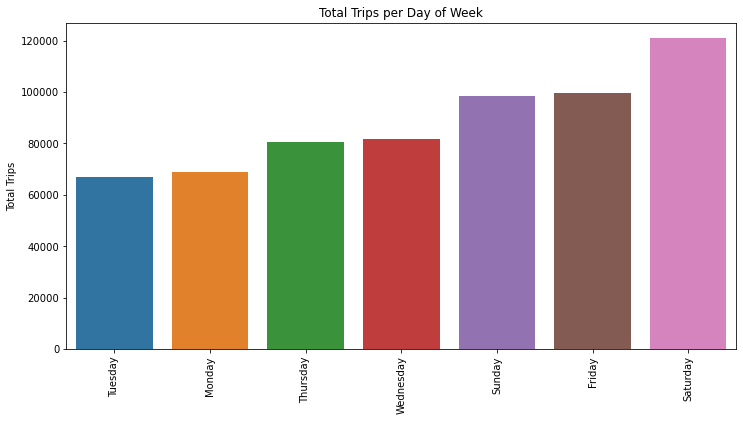

In [47]:
plt.figure(figsize=(12,6))
sns.barplot(x=day_count.index, y='Total Trips', data = day_count) 
plt.xticks(rotation=90)
plt.title('Total Trips per Day of Week')
plt.xlabel('')
plt.show()

The most e-scooter trips occurred on a Saturday followed by Friday and Sunday. The higher usage of E-scooters on weekends would suggest that this mode of transport is being utilised for recreational purposes rather than the daily commute to and from work. 

In [48]:
#Table with number of trips per hour of day
hour_count = escoot.groupby(["Start_Time", "Vendor"], as_index= False).size()
hour_count = hour_count.pivot(index = 'Start_Time', columns = 'Vendor', values = 'size').fillna(0)
hour_count['Total Trips'] = hour_count['bird']+hour_count['lime']+hour_count['spin']
hour_count.index = pd.to_datetime(hour_count.index)
hour_count.index = hour_count.index.time
hour_count = hour_count.sort_index(ascending=True)
hour_count.head(24)

Vendor,bird,lime,spin,Total Trips
00:00:00,0.0,1.0,16.0,17.0
01:00:00,0.0,2.0,10.0,12.0
02:00:00,0.0,0.0,7.0,7.0
03:00:00,0.0,0.0,25.0,25.0
04:00:00,0.0,0.0,21.0,21.0
05:00:00,802.0,1489.0,849.0,3140.0
06:00:00,1818.0,2885.0,1492.0,6195.0
07:00:00,2819.0,4429.0,2797.0,10045.0
08:00:00,4171.0,6250.0,4020.0,14441.0
09:00:00,4683.0,8035.0,4679.0,17397.0


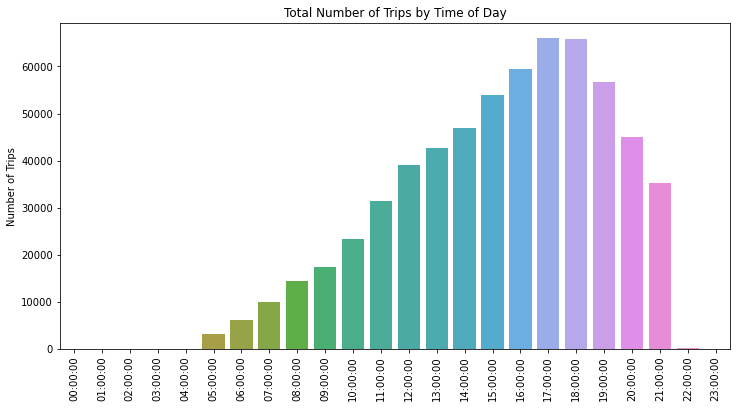

In [49]:
plt.figure(figsize=(12,6))
sns.barplot(data = hour_count, x = hour_count.index, y = hour_count['Total Trips'])
plt.xticks(rotation=90)
plt.title('Total Number of Trips by Time of Day')
plt.xlabel('')
plt.ylabel('Number of Trips')
plt.show()

E-scooter usage builds from early morning (5am) to a peak of 65,959 trips at 5pm, then drops off. From the hours of 11pm to 4am e-scooters are not used. Relatively low usage during the morning peak hour times suggests that the e-scooters are not being used for travel to work. Taking into consideration that usage is significantly higher on the weekends and usage is higher during the afternoon/evening it would suggest that the scooters were used primarily for recreational transport. 

## 1.8 E-scooter Usage During the Program by Total Distance Travelled and Total Duration of Trips

In [50]:
dist_dur = escoot.groupby(["Start_Date", "Vendor"], as_index= False).sum()
dist_dur['Start_Date'] = dist_dur['Start_Date'].apply(pd.to_datetime)
dist_dur.drop(columns=['Start Community Area Number', 'End Community Area Number'], inplace=True)
dist_dur = dist_dur.pivot(index = 'Start_Date', columns = 'Vendor').fillna(0)
dist_dur['Totals', 'Total Dist'] = dist_dur['Trip Distance','bird']+dist_dur['Trip Distance','lime']+dist_dur['Trip Distance','spin']
dist_dur['Totals', 'Total Dur'] = dist_dur['Trip Duration','bird']+dist_dur['Trip Duration','lime']+dist_dur['Trip Duration','spin']
dist_dur.head()

Trip Distance                   Trip Duration                    \
Vendor              bird     lime     spin          bird     lime     spin   
Start_Date                                                                   
2020-08-12       3174399  3915817  2983056       1004797  2207883  1004157   
2020-08-13       4679819  4094910  3211903       1398379  2620473  1134769   
2020-08-14       7692912  3327086  4087975       2192735  2085840  1415158   
2020-08-15       8280249  3951700  4730218       2554032  2525489  1588281   
2020-08-16       8824602  4319177  5794698       2841662  2793254  2039074   

               Totals            
Vendor     Total Dist Total Dur  
Start_Date                       
2020-08-12   10073272   4216837  
2020-08-13   11986632   5153621  
2020-08-14   15107973   5693733  
2020-08-15   16962167   6667802  
2020-08-16   18938477   7673990

In [51]:
#descriptive statistics for total trips per day
round(dist_dur['Totals'].describe(), 2)

Vendor,Total Dist,Total Dur
count,123.00,123.00
mean,12765583.46,4527641.61
std,8418865.23,3310656.96
min,1220067.00,405873.00
25%,5341421.50,1648581.50
50%,11751592.00,3869610.00
75%,18400024.00,6731222.00
max,34686455.00,13893747.00


The average total distance traveled per day is 12,765.58 km with a min of 1,220.07 km and a max of 34,686.46 km.

The average total duartion of trips per day is 1257 hrs 40 min 41 sec with a min of 112 hrs 44 min 33 sec and a max of 3859 hrs 22 min 27 sec.

In [52]:
min_dist_date = dist_dur.index[dist_dur['Totals', 'Total Dist'] == dist_dur['Totals', 'Total Dist'] .min()]
max_dist_date = dist_dur.index[dist_dur['Totals', 'Total Dist'] == dist_dur['Totals', 'Total Dist'].max()]

min_dur_date = dist_dur.index[dist_dur['Totals', 'Total Dur'] == dist_dur['Totals', 'Total Dur'] .min()]
max_dur_date = dist_dur.index[dist_dur['Totals', 'Total Dur'] == dist_dur['Totals', 'Total Dur'].max()]

print(f' The date with the smallest total distance travelled was: {min_dist_date[0].strftime("%Y-%m-%d")}')
print(f' The date with the largest total distance travelled was: {max_dist_date[0].strftime("%Y-%m-%d")}')

print(f' The date with the smallest total duration of trips travelled was: {min_dur_date[0].strftime("%Y-%m-%d")}')
print(f' The date with the largest total duration of trips travelled was: {max_dur_date[0].strftime("%Y-%m-%d")}')


 The date with the smallest total distance travelled was: 2020-12-12
 The date with the largest total distance travelled was: 2020-09-05
 The date with the smallest total duration of trips travelled was: 2020-12-12
 The date with the largest total duration of trips travelled was: 2020-09-05


In [53]:
def convert_dist(meters):
    km = round(meters/1000,2)
    return km

dist_dur['Totals','Total Dist'] = dist_dur['Totals','Total Dist'].apply(lambda x: convert_dist(x))

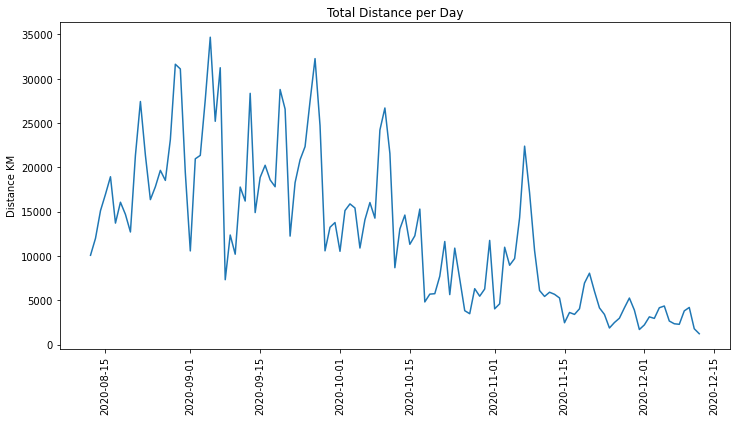

In [54]:
plt.figure(figsize=(12,6))
sns.lineplot(data = dist_dur, x = dist_dur.index, y = dist_dur.Totals['Total Dist'])
plt.xticks(rotation=90)
plt.title('Total Distance per Day')
plt.xlabel('')
plt.ylabel('Distance KM')
plt.show()

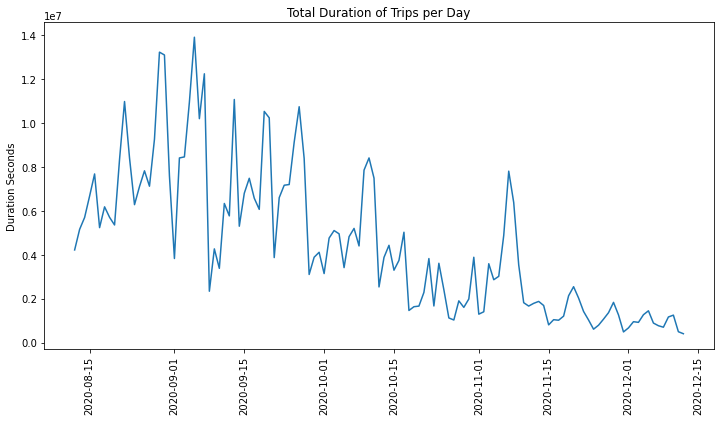

In [55]:
plt.figure(figsize=(12,6))
sns.lineplot(data = dist_dur, x = dist_dur.index, y = dist_dur.Totals['Total Dur'])
plt.xticks(rotation=90)
plt.title('Total Duration of Trips per Day')
plt.xlabel('')
plt.ylabel('Duration Seconds')
plt.show()

The total distance travelled per day and total trip duration per day follows a similar pattern to the number of trips taken per day. The variability between days is large, the highest values are observed during the begining of the pilot period and remain relatively level during September after which they gradually decline for the remaining period of the pilot program.

## 1.9 Vendor Investigation

The data was investigated to understand the pattern of usage between vendors.

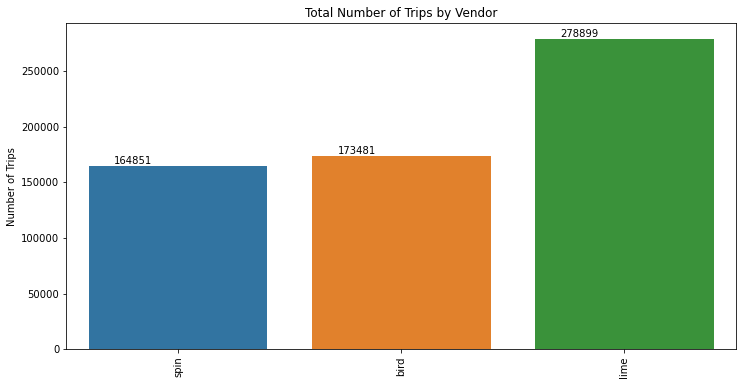

In [56]:
#most popular vendor
plt.figure(figsize=(12,6))
ax = sns.countplot(data = escoot, x = 'Vendor')
for p in ax.patches:
    ax.annotate(f'\n{p.get_height()}', (p.get_x()+0.2, p.get_height()), ha = 'center', va='bottom', color='black', size=10)
plt.xticks(rotation=90)
plt.title('Total Number of Trips by Vendor')
plt.xlabel('')
plt.ylabel('Number of Trips')
plt.show()

Lime was the most popular vendor with 278,899 trips. The vendors Spin and Bird had a similar number of trips. 

In [57]:
#Popularity by region
pop_vendor = trip_start[['community','bird', 'lime', 'spin']]
pop_vendor = pop_vendor.set_index('community')
pop_vendor = pd.DataFrame(pop_vendor.idxmax(axis=1), columns=['Top_Vendor'])
pop_vendor.head()

,Top_Vendor
community,
ALBANY PARK,spin
ARCHER HEIGHTS,lime
ARMOUR SQUARE,lime
ASHBURN,lime
AUBURN GRESHAM,lime


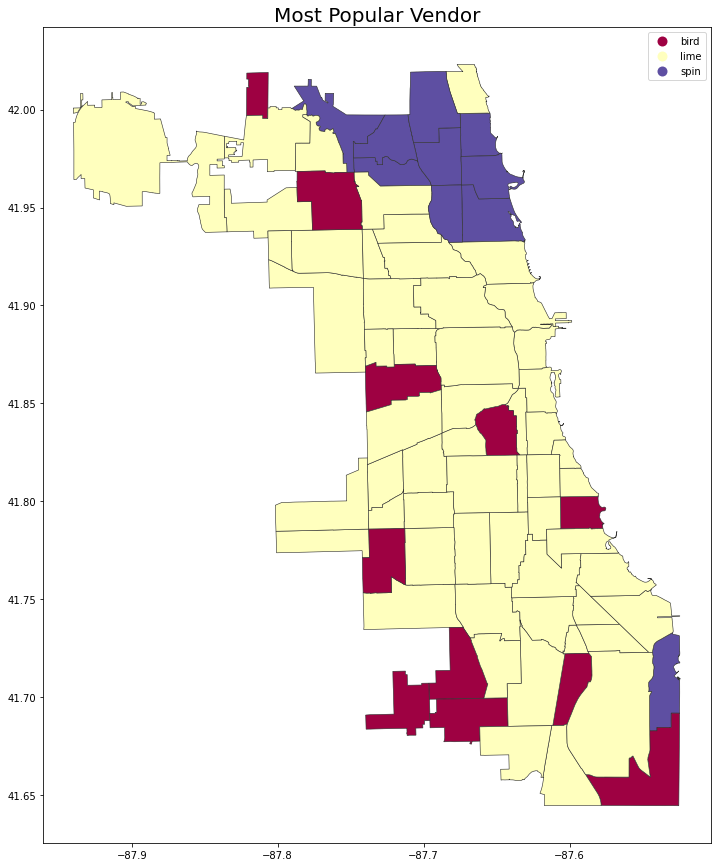

In [58]:
trip_start = pd.merge(trip_start,pop_vendor, left_on = 'community', right_on=pop_vendor.index)
trip_start["Top_Vendor"] = trip_start["Top_Vendor"].astype('category')
trip_start["Top_Vendor_cat"] = trip_start["Top_Vendor"].cat.codes
trip_start.plot(column='Top_Vendor', categorical=True, cmap='Spectral',figsize=(15, 15), linewidth=.6, edgecolor='0.2',legend=True)
plt.title('Most Popular Vendor',fontsize=20)
plt.show()

The map shows that the Lime vendor is the most popular vendor for most communities across the city. The spin vendor is popular for a collection of communities to the north east of the city and includes the community with the most trips, Lake View. The bird vendor is popular for a number of communities which are sporadically spread across the city.

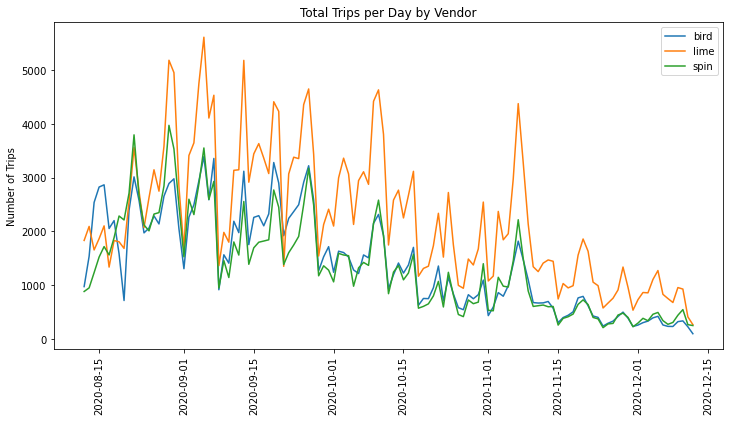

In [59]:
#usage by vendor over time 
plt.figure(figsize=(12,6))
sns.lineplot(data = date_count, x = date_count.index, y = 'bird')
sns.lineplot(data = date_count, x = date_count.index, y = 'lime')
sns.lineplot(data = date_count, x = date_count.index, y = 'spin')
plt.xticks(rotation=90)
plt.title('Total Trips per Day by Vendor')
plt.xlabel('')
plt.ylabel('Number of Trips')
plt.legend(['bird','lime','spin'])
plt.show()

During the very early stages of the pilot program, bird was the most popular vendor however lime quickly took over and stayed the most popular throughout most of the pilot program. 
The bird and spin vendors remained similar in popularity throughout the program. 
Trip numbers fell for all vendors at similar rates from October to the end of the program. 

## 1.10 Summary

Upon the removal of outliers from the e-scooter trip data it was found a total of 617, 231 trips were completed over the 123 days of the pilot program. The average trip distance was 2.5km and the average trip duration lasted for 15 minutes and 2 seconds. 

Several null values were noticed within the start and end community area name attributes. Upon investigation it was concluded that the most likely reason for the null values was that the scooter had started or completed a trip outside the community areas participating within the program. The largest number of null values were recorded on the border communities. The community of Austin had the largest number of null values. The lime vendor had a disproportionate number of null values in comparison to the spin and bird vendors. It is suggested that the way in which the lime vendor communicates where a user can and cannot use the scooter is evaluated.

It was found that the starting location of trips were not evenly distributed throughout the communities. The communities of Lake View, Lincoln Park and West Town had a larger number of trips compared to the other communities. These communities are the location of several popular recreational hotspots within Chicago including a number of large parks, beaches and the zoo. The communities where the least number of trips started was Ohare and Edison Park. This can be explained as a large portion of these communities make up the e-scooter exclusion zone. 

The number of trips ending within a community followed a near identical distribution to the number of trips starting in a community. This would suggest that most trips are localised to within a community area. This is further supported by the migration pattern data which showed only a small number of trips started in one community and ended in another. The community with the largest negative trip migration Lincoln Park. As surrounding communities had positive migration users are starting trips within Lincoln Park and travelling to surrounding suburbs. 
Over the 123 day period of the program it was found that the number of trips taken peaked early and remained relatively stable throughout September. However from October onwards the number of trips began to decline at a steady rate until the program concluded. The average number of trips taken per day was 5,018.14. 

A difference was observed within the number of trips by day of the week. Saturday had the largest number of trips taken followed by Friday and Sunday. The least number of trips taken were taken on Mondays and Tuesdays. This suggests that the scooters are being used for recreational travel rather than everyday commuting. This is supported by the most popular hour of the day that trips are taken. The most popular time for a trip to be taken was in the afternoon/evening between 5pm and 6pm. Of note was the small number  of trips taken during the typical morning peak hour times. 

It was found that Lime was the most popular vendor completing the largest number of trips. The vendors spin and bird completed a similar number of trips. 
